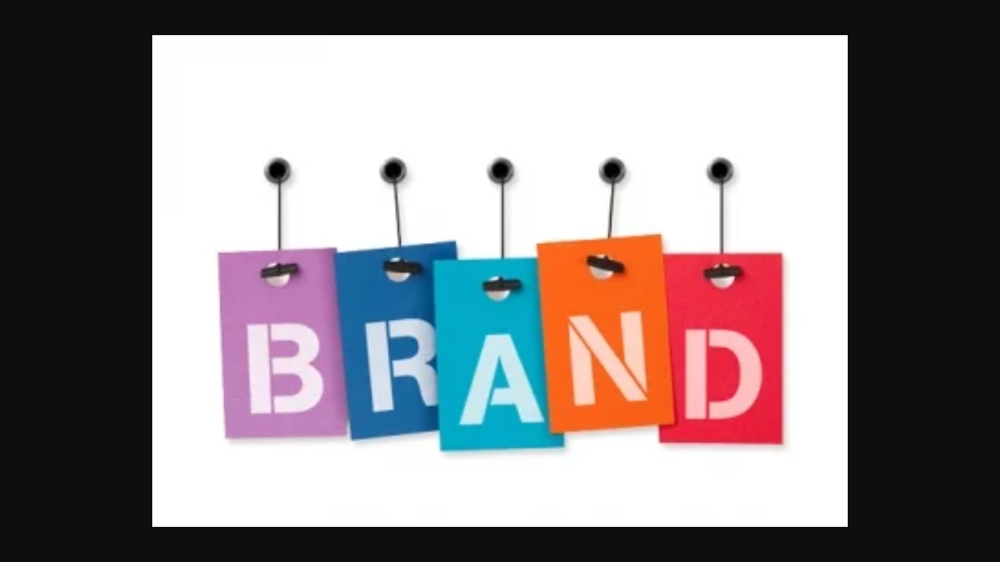

<h1 align="CENTER"><b>DESAFÍO DATA ANALYST</b></h1>
<br><br><br>

## Enunciados: 

<ol type="a">
  <li><b>Códigos Postales</b> que realizaron más llamadas al 911.</li>
  <li><b>Ciudades</b> que realizaron más llamadas al 911.</li>
  <li>Títulos únicos en la columna <b>title</b>.</li>
  <li>Hacer columna extra <b>Reason</b> que contenga el departamento de emergencias que atendió la llamada (EMS, Fire y Traffic).</li>
  <li><b>Departamento</b> que recibe más llamadas. Grafique.</li>
  <li>Calcule Correlación de Pearson entre <b>Zipcode</b>, <b>Latitud</b> y <b>Longitud</b> ¿A partir de qué valor tomaría las variables como correlacionadas? ¿Están correlacionadas? ¿Tiene sentido hacer este cálculo? Justifique sus respuestas. Use otros métodos si corresponde.</li>
</ol>




# 2.1 Manipulando bases de datos

In [ ]:
# Libraries
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots

# To display df stylers (for example, 2 in the same cell)(This is not necessary to show just a styler in a cell.)
from IPython.display import display_html
from IPython.core.display import display, HTML

In [ ]:
#Setting color palette
colors = sns.blend_palette(['pink','blue','lightblue','orange','red'], 8)[:]#9)[5:]
cmap = sns.blend_palette(['pink','blue','lightblue','orange','red'], 8, as_cmap=True)#9)[5:]


In [ ]:
# Uploading data.
!gdown --id 1vad-Cgs59Tc1O8yZdLwjf9hsfEkfC5ty
df = pd.read_csv("./911.csv")


Downloading...
From: https://drive.google.com/uc?id=1vad-Cgs59Tc1O8yZdLwjf9hsfEkfC5ty
To: /content/911.csv
100% 123M/123M [00:01<00:00, 81.2MB/s]


In [ ]:
# Showing df
df.head(5)

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
0,40.297876,-75.581294,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525.0,EMS: BACK PAINS/INJURY,2015-12-10 17:10:52,NEW HANOVER,REINDEER CT & DEAD END,1
1,40.258061,-75.264680,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446.0,EMS: DIABETIC EMERGENCY,2015-12-10 17:29:21,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN,1
2,40.121182,-75.351975,HAWS AVE; NORRISTOWN; 2015-12-10 @ 14:39:21-St...,19401.0,Fire: GAS-ODOR/LEAK,2015-12-10 14:39:21,NORRISTOWN,HAWS AVE,1
3,40.116153,-75.343513,AIRY ST & SWEDE ST; NORRISTOWN; Station 308A;...,19401.0,EMS: CARDIAC EMERGENCY,2015-12-10 16:47:36,NORRISTOWN,AIRY ST & SWEDE ST,1
4,40.251492,-75.603350,CHERRYWOOD CT & DEAD END; LOWER POTTSGROVE; S...,NaN,EMS: DIZZINESS,2015-12-10 16:56:52,LOWER POTTSGROVE,CHERRYWOOD CT & DEAD END,1


¿Hay filas duplicadas?

In [ ]:
#@title
print('Cantidad de celdas duplicadas eliminadas: ' + str(len(df)-len(df)))
df = df.drop_duplicates()

Cantidad de celdas duplicadas eliminadas: 0


In [ ]:
#@title

df = df.dropna(axis=0) #, subset=['zip']

print('Cantidad de celdas con valores "null":\n ')
df.isnull().sum()


Cantidad de celdas con valores "null":
 


lat          0
lng          0
desc         0
zip          0
title        0
timeStamp    0
twp          0
addr         0
e            0
dtype: int64

### a) Top 5 de `Zipcode` que realizan llamadas al 911:

In [ ]:
#@title
df['zip'].value_counts().head(5)

19401.0    45573
19464.0    43892
19403.0    34874
19446.0    32255
19406.0    22450
Name: zip, dtype: int64

Para tener en cuenta.

In [ ]:
#@title
print('La cantidad de llamadas que no especifican Zipcode: '+ str(df['zip'].isnull().sum()))

perc_null = (df['zip'].isnull().sum()*100)/(len(df['zip']))
print('Esta cantidad corresponde al: '+str(round(perc_null,2)) + '% de los datos')


La cantidad de llamadas que no especifican Zipcode: 0
Esta cantidad corresponde al: 0.0% de los datos


### b) Top 5 de `ciudades` que realizan llamadas al 911:

In [ ]:
#@title
df['twp'].value_counts().head(5)

LOWER MERION    47470
ABINGTON        38119
NORRISTOWN      35864
POTTSTOWN       26832
CHELTENHAM      26628
Name: twp, dtype: int64

Para tener en cuenta. La cantidad de llamadas que no especifican Zipcode:

In [ ]:
#@title
print('La cantidad de llamadas que no especifican la ciudad es: '+ str(df['twp'].isnull().sum()))

perc_null = (df['twp'].isnull().sum()*100)/(len(df['twp']))
print('Esta cantidad corresponde al: '+str(round(perc_null,2)) + '% de los datos')

La cantidad de llamadas que no especifican la ciudad es: 0
Esta cantidad corresponde al: 0.0% de los datos


### c) Cantidad de Tipos de `títulos` únicos que tiene la columna ‘title’:

In [ ]:
#@title
len(df['title'].unique())

144

### Creando columna `"Reason"` 
Contiene el departamente correspondiente a cada llamada.

In [ ]:
df['Reason'] = df['title'].apply(lambda x:  x.split(':')[0] if ':' in x else 0)

In [ ]:
#@title
df.head(3)

,lat,lng,desc,zip,title,timeStamp,twp,addr,e,Reason
0,40.297876,-75.581294,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525.0,EMS: BACK PAINS/INJURY,2015-12-10 17:10:52,NEW HANOVER,REINDEER CT & DEAD END,1,EMS
1,40.258061,-75.264680,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446.0,EMS: DIABETIC EMERGENCY,2015-12-10 17:29:21,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN,1,EMS
2,40.121182,-75.351975,HAWS AVE; NORRISTOWN; 2015-12-10 @ 14:39:21-St...,19401.0,Fire: GAS-ODOR/LEAK,2015-12-10 14:39:21,NORRISTOWN,HAWS AVE,1,Fire


### e) Departamento que recibe más llamadas:

In [ ]:
#@title
df['Reason'].value_counts().head(1)

EMS    304690
Name: Reason, dtype: int64

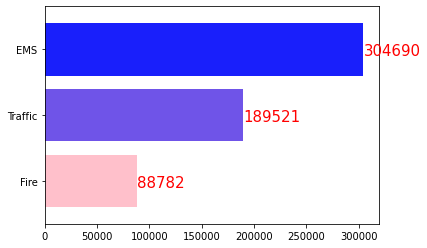

In [ ]:
#@title
chart = df['Reason'].value_counts().sort_values(ascending=True, na_position='first').plot(kind='barh',rot=0,figsize=[6,4], width=.8, color=colors)#, colormap='Paired')
for i in chart.patches:
    chart.text(i.get_width()+.1, i.get_y()+.31, \
            str(round((i.get_width()), 2)), fontsize=15, color='r')
plt.show()

### f) Coeficiente de correlación de Pearson entre el `Zipcode y la latitud` y el `Zipcode con la longitud`

In [ ]:
#@title
# whith outliers
df_corr = df[['zip', 'lat', 'lng']].corr().loc[['lat','lng'],['zip']]
styler1 = df_corr.style.background_gradient(cmap='RdBu',axis=None, vmin=-.5, vmax=.5).set_table_attributes("style='display:inline'").set_caption('Con valores atípicos')
# Spectral
# without outliers
df_corr = df[(df['lat']>40) & (df['lat']<40.42) & (df['lng']>-75.7)][['zip', 'lat', 'lng']].corr().loc[['lat','lng'],['zip']]
styler2 = df_corr.style.background_gradient(cmap='RdBu',axis=None, vmin=-.5, vmax=.5).set_table_attributes("style='display:inline'").set_caption('Sin valores atípicos')

display_html(styler1._repr_html_()+'&nbsp&nbsp&nbsp&nbsp&nbsp&nbsp&nbsp&nbsp&nbsp&nbsp&nbsp&nbsp&nbsp'+styler2._repr_html_(), raw=True)

,zip
lat,-0.042382
lng,-0.099851
,zip
lat,-0.002690
lng,-0.371001


# <u>¿Correlación de Pearson? ¿Por qué sí? ¿Por qué no?</u>



<div class="alert alert-block alert-info"><font color='black'>
<div align="right"><b>"En estadística, el coeficiente de correlación de Pearson es una medida de dependencia lineal entre dos variables aleatorias cuantitativas."</b></div>
<div align="right"><a href=https://es.wikipedia.org/wiki/Coeficiente_de_correlación_de_Pearson)>Wikipedia</a></div>

> Tal como se puede suponer, es natural que exista una relación entre las coordenadas geográficas y los códigos postales (históricamente, en EE UU  se los numeró desde el este al oeste), sin embargo,  no tiene mucho sentido buscar una `correlación lineal` entre ellos (como lo es la correlación Pearson). 

> En otras palabras, aunque parece que la relación con la latitud pudiera tener cierta linealidad, no hay que olvidar que se está hablando de un CÓDIGO. Un código que también se distribuye de arriba hacia abajo y de abajo hacia arriba.

> Es decir, si bien todas son variables numéricas, la forma en que se estableció el código postal no tiene relación con el aumento o la disminución de las latitudes y longitudes de Estados Unidos.

<b>A continuación se puede apreciar fácilmente la forma en que la correlación puede ser sumamente engañosa (en este caso, principalmente debido a los valores atípicos).</b>
</font></div>
Téngase en cuenta que los gráficos son interactivos. Así que, se puede hacer zoom a los datos que más interesen.

In [ ]:
#@title

title = """<html><h2 align="center"><b><u>Relación Lineal entre el Código Postal y la Latitud</u></b></h2></html>""".format()
display(HTML(title))  

# Sample plot for the interactive library plotly
df_sample = df.sample(n=250000, random_state=1)

# Determining a subplot grid.
fig = make_subplots(rows=2, cols=3,specs=[ [{}, {'colspan': 2, 'rowspan': 2}, None],[{}, {}, {}]])
# Plotting
fig0 = px.box(df_sample, x='lat', color_discrete_sequence=['#0081cb'])
fig1 = px.histogram(df_sample, x= 'lat', color_discrete_sequence=['#0081cb'])
fig2 = px.scatter(x =df_sample['lat'], y = df_sample['zip'], trendline="ols", color_discrete_sequence=['#0081cb'], render_mode='webgl')

# Placing plots in the subplot grid
for trace in fig0.data:
    fig.add_trace(trace, 1, 1)
for trace in fig1.data:
    fig.add_trace(trace, 2, 1)
for trace in fig2.data:
    fig.add_trace(trace, 1, 2)
# Labeling axis
fig['layout']['xaxis3']['title']='lat'
fig['layout']['yaxis3']['title']='Frequency'
fig['layout']['xaxis2']['title']='lat'
fig['layout']['yaxis2']['title']='zip'
# Removing space between plots
fig.update_layout(plot_bgcolor='#c9f2eb')
# Showing
fig.show()



/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



In [ ]:
#@title
results = px.get_trendline_results(fig2)
results = results.iloc[0]["px_fit_results"].summary()
print(results)

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.008
Model:                            OLS   Adj. R-squared:                  0.008
Method:                 Least Squares   F-statistic:                     2123.
Date:                Thu, 10 Feb 2022   Prob (F-statistic):               0.00
Time:                        22:53:03   Log-Likelihood:            -1.7912e+06
No. Observations:              250000   AIC:                         3.582e+06
Df Residuals:                  249998   BIC:                         3.582e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       3.012e+04    236.273    127.486      0.0

In [ ]:
#@title

title = """<html><h2 align="center"><b><u>Relación Lineal entre el Código Postal y la Longitud</u></b></h2></html>""".format()
display(HTML(title))  

# Determining a subplot grid.
fig = make_subplots(rows=2, cols=3,specs=[ [{}, {'colspan': 2, 'rowspan': 2}, None],[{}, {}, {}]])
# Plotting
fig0 = px.box(df_sample, x='lng', color_discrete_sequence=['#0081cb'])
fig1 = px.histogram(df_sample, x= 'lng', color_discrete_sequence=['#0081cb'])
fig2 = px.scatter(x =df_sample['lng'], y = df_sample['zip'], trendline="ols", color_discrete_sequence=['#0081cb'], render_mode='webgl')
# Placing plots in the subplot grid
for trace in fig0.data:
    fig.add_trace(trace, 1, 1)
for trace in fig1.data:
    fig.add_trace(trace, 2, 1)
for trace in fig2.data:
    fig.add_trace(trace, 1, 2)
# Labeling axis
fig['layout']['xaxis3']['title']='lat'
fig['layout']['yaxis3']['title']='Frequency'
fig['layout']['xaxis2']['title']='lat'
fig['layout']['yaxis2']['title']='zip'
# Removing space between plots
fig.update_layout(plot_bgcolor='#c9f2eb')
# Showing
fig.show()

In [ ]:
#@title
results = px.get_trendline_results(fig2)
results = results.iloc[0]["px_fit_results"].summary()
print(results)

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.018
Model:                            OLS   Adj. R-squared:                  0.018
Method:                 Least Squares   F-statistic:                     4573.
Date:                Thu, 10 Feb 2022   Prob (F-statistic):               0.00
Time:                        22:53:17   Log-Likelihood:            -1.7900e+06
No. Observations:              250000   AIC:                         3.580e+06
Df Residuals:                  249998   BIC:                         3.580e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       1.305e+04     91.450    142.722      0.0

# <u>Algunas alternativas a la correlación lineal</u>

# a) k means

In [ ]:
#@title
from sklearn.cluster import KMeans


In [ ]:
#@title

kmeans2 = KMeans(n_clusters=3,random_state=0).fit(df[(df['lat']>40) & (df['lat']<40.42) & (df['lng']>-75.7)][['zip', 'lat', 'lng']])

kmeans2.labels_

array([0, 0, 0, ..., 1, 0, 1], dtype=int32)

In [ ]:
#@title
np.unique(kmeans2.labels_,return_counts=True)

(array([0, 1, 2], dtype=int32), array([329744, 227841,  14699]))

> **Las clusterizaciones probadas no mejoran los resultados.**
> Se puede ver fácilmente que, los datos son agrupados de forma poco pareja y con una dispersión significativa.

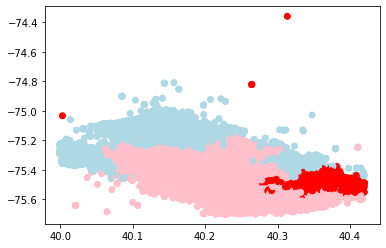

In [ ]:
#@title
plt.scatter(df[(df['lat']>40) & (df['lat']<40.42) & (df['lng']>-75.7)][[ 'lat']],
            df[(df['lat']>40) & (df['lat']<40.42) & (df['lng']>-75.7)][['lng']]
            ,c=kmeans2.labels_, cmap=cmap)
plt.show()

# b) Hierarchical clustering

In [ ]:
#@title
from sklearn.cluster import AgglomerativeClustering

In [ ]:
#@title
clstr = AgglomerativeClustering(n_clusters=3)
clstr.fit(df[(df['lat']>40) & (df['lat']<40.42) & (df['lng']>-75.7)][['zip', 'lat', 'lng']][:1000])

AgglomerativeClustering(n_clusters=3)

> En este caso la dispersión es más significativa y al mismo tiempo que las agrupaciones son menos definidas.

<function matplotlib.pyplot.show>

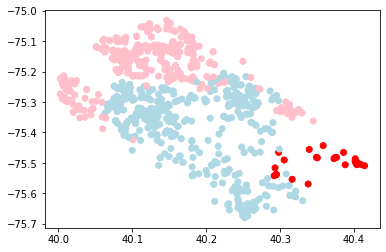

In [ ]:
#@title
plt.scatter(df[(df['lat']>40) & (df['lat']<40.42) & (df['lng']>-75.7)][['lat']][:1000]
            ,df[(df['lat']>40) & (df['lat']<40.42) & (df['lng']>-75.7)][['lng']][:1000]
            ,cmap=cmap,c=clstr.fit_predict(df[(df['lat']>40) & (df['lat']<40.42) & (df['lng']>-75.7)][['zip', 'lat', 'lng']][:1000]))
plt.show

# c) Árbol de regresión


In [ ]:
#@title
from sklearn import tree
from sklearn.metrics import r2_score


In [ ]:
#@title
clf=tree.DecisionTreeRegressor()



df1=df.head(50000)
dftest=df.tail(50000)


X=df1[(df1['lat']>40) & (df1['lat']<40.42) & (df1['lng']>-75.7)][['zip', 'lat', 'lng']]
X_test=dftest[(dftest['lat']>40) & (dftest['lat']<40.42) & (dftest['lng']>-75.7)][['zip', 'lat', 'lng']]

Y=df1[(df1['lat']>40) & (df1['lat']<40.42) & (df1['lng']>-75.7)][['lat']]
Y_test=dftest[(dftest['lat']>40) & (dftest['lat']<40.42) & (dftest['lng']>-75.7)][['lat']]




clf=clf.fit(X,Y)
Y_pred=clf.predict(X)
Y_pred_test=clf.predict(X_test)

print("R cuadrado: ",r2_score(Y,Y_pred))
print("R cuadrado test: ",r2_score(Y_test,Y_pred_test))

R cuadrado:  0.9999999999264225
R cuadrado test:  0.9999998587719539
